# Project: FordGoBike_System Data Exploration

BY CHRISTIAN OLUOMA

# Table of Contents

- Introduction
- Data Wrangling
- Exploratory Data Analysis
- Conclusion

# Introduction

## Dataset Description


This dataset includes information about individual rides made in a bike-sharing system covering the greater San Francisco Bay area.

## Question for Analysis


- When are most trips taken in terms of time of day, day of the month?
- How long does the average trip take?
- Does the length of the average trip depends on if a user is a subscriber or a customer?

# Data Wrangling

## Data Gathering

In [1]:
# import required python packages

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px  # For plotting maps
import warnings
warnings.filterwarnings('ignore') # Suppresses any warning
%matplotlib inline

In [2]:
# Load dataset into pandas

FordGoBike= pd.read_csv('201902-fordgobike-tripdata.csv')

## Data Assessing

In [3]:
FordGoBike.sample(10)    # Inspect Dataset by visual assessment

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
48826,134,2019-02-22 06:59:24.0280,2019-02-22 07:01:38.9110,122.0,19th St at Mission St,37.760299,-122.418892,223.0,16th St Mission BART Station 2,37.764765,-122.420091,6419,Subscriber,1988.0,Other,Yes
58716,299,2019-02-20 23:12:09.4880,2019-02-20 23:17:09.2500,248.0,Telegraph Ave at Ashby Ave,37.855956,-122.259795,267.0,Derby St at College Ave,37.861804,-122.253569,5760,Subscriber,1982.0,Male,No
87111,766,2019-02-17 10:39:56.9910,2019-02-17 10:52:43.7670,110.0,17th & Folsom Street Park (17th St at Folsom St),37.763708,-122.415204,370.0,Jones St at Post St,37.787327,-122.413278,5277,Subscriber,1987.0,Male,No
109746,448,2019-02-12 18:40:09.6750,2019-02-12 18:47:37.8140,385.0,Woolsey St at Sacramento St,37.850578,-122.278175,265.0,Ninth St at Parker St,37.858868,-122.291209,1025,Subscriber,1975.0,Male,No
127985,483,2019-02-10 14:22:48.8580,2019-02-10 14:30:52.2310,36.0,Folsom St at 3rd St,37.783830,-122.398870,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,5422,Subscriber,1993.0,Male,No
24938,1064,2019-02-25 17:28:37.0350,2019-02-25 17:46:21.2830,14.0,Clay St at Battery St,37.795001,-122.399970,93.0,4th St at Mission Bay Blvd S,37.770407,-122.391198,5030,Subscriber,1993.0,Female,No
170954,268,2019-02-04 07:19:54.0300,2019-02-04 07:24:22.3210,18.0,Telegraph Ave at Alcatraz Ave,37.850222,-122.260172,241.0,Ashby BART Station,37.852477,-122.270213,4665,Subscriber,1989.0,Male,No
170489,450,2019-02-04 08:10:38.5120,2019-02-04 08:18:08.6880,267.0,Derby St at College Ave,37.861804,-122.253569,246.0,Berkeley Civic Center,37.869060,-122.270556,4544,Subscriber,1966.0,Male,No
64668,840,2019-02-20 11:18:01.0660,2019-02-20 11:32:01.4360,44.0,Civic Center/UN Plaza BART Station (Market St ...,37.781074,-122.411738,102.0,Irwin St at 8th St,37.766883,-122.399579,4407,Subscriber,1987.0,Male,No
28736,301,2019-02-25 08:28:02.8680,2019-02-25 08:33:04.0600,62.0,Victoria Manalo Draves Park,37.777791,-122.406432,67.0,San Francisco Caltrain Station 2 (Townsend St...,37.776639,-122.395526,4946,Subscriber,1990.0,Female,No


In [4]:
FordGoBike.shape     # Inspect the number of entries and features in the dataset

(183412, 16)

The dataset has 183,412 riding entries and 16 features.

In [5]:
FordGoBike.info()     # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183412 non-null  int64  
 1   start_time               183412 non-null  object 
 2   end_time                 183412 non-null  object 
 3   start_station_id         183215 non-null  float64
 4   start_station_name       183215 non-null  object 
 5   start_station_latitude   183412 non-null  float64
 6   start_station_longitude  183412 non-null  float64
 7   end_station_id           183215 non-null  float64
 8   end_station_name         183215 non-null  object 
 9   end_station_latitude     183412 non-null  float64
 10  end_station_longitude    183412 non-null  float64
 11  bike_id                  183412 non-null  int64  
 12  user_type                183412 non-null  object 
 13  member_birth_year        175147 non-null  float64
 14  memb

Some features like start_station_id, start_station_name, end_station_id, end_station_name, member_birth_year and member_gender tend to have NaN(Not a Number) values.

Some features have incorrect datatype and should be changed.

In [6]:
FordGoBike.duplicated()    # Inspect for duplicated rows

0         False
1         False
2         False
3         False
4         False
          ...  
183407    False
183408    False
183409    False
183410    False
183411    False
Length: 183412, dtype: bool

In [7]:
FordGoBike.duplicated().sum()   # Inspect for the sum of duplicated rows

0

There are no duplicate entries in the dataset.

In [8]:
FordGoBike.isnull().sum()    # Inspect for the sum of Null Values

duration_sec                  0
start_time                    0
end_time                      0
start_station_id            197
start_station_name          197
start_station_latitude        0
start_station_longitude       0
end_station_id              197
end_station_name            197
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8265
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

The number of missing values in the following features; start_station_id, start_station_name, end_station_id, end_station_name, member_birth_year and member_gender can be seen.

In [9]:
FordGoBike.nunique()    # Inspect for unique Values

duration_sec                 4752
start_time                 183401
end_time                   183397
start_station_id              329
start_station_name            329
start_station_latitude        334
start_station_longitude       335
end_station_id                329
end_station_name              329
end_station_latitude          335
end_station_longitude         335
bike_id                      4646
user_type                       2
member_birth_year              75
member_gender                   3
bike_share_for_all_trip         2
dtype: int64

The number of unique values for each features can be seen.

In [10]:
FordGoBike.describe()    # Inspect statistical summary of numerical features

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id,member_birth_year
count,183412.000000,183215.000000,183412.000000,183412.000000,183215.000000,183412.000000,183412.000000,183412.000000,175147.000000
mean,726.078435,138.590427,37.771223,-122.352664,136.249123,37.771427,-122.352250,4472.906375,1984.806437
std,1794.389780,111.778864,0.099581,0.117097,111.515131,0.099490,0.116673,1664.383394,10.116689
min,61.000000,3.000000,37.317298,-122.453704,3.000000,37.317298,-122.453704,11.000000,1878.000000
25%,325.000000,47.000000,37.770083,-122.412408,44.000000,37.770407,-122.411726,3777.000000,1980.000000
50%,514.000000,104.000000,37.780760,-122.398285,100.000000,37.781010,-122.398279,4958.000000,1987.000000
75%,796.000000,239.000000,37.797280,-122.286533,235.000000,37.797320,-122.288045,5502.000000,1992.000000
max,85444.000000,398.000000,37.880222,-121.874119,398.000000,37.880222,-121.874119,6645.000000,2001.000000


From the summary statistics of the dataset, there tend to be  outliers in the member_birth_year feature since users born in the year 1878 wont be able to ride bikes. These outliers need to be sorted and removed.

Values above the upper quartile of the duration tend to be very large. We need to convert the duration from seconds to minutes.

The start_station_id, end_station_id and bike_id should be converted to a string datatype or rather be removed since they add no value to our analysis.

In [11]:
round(FordGoBike['member_birth_year'].mean())  # Obtain the mean value of user birth year rounded to a whole number

1985

In [12]:
FordGoBike['member_birth_year'].value_counts()   # Get the count of individual user birth year

1988.0    10236
1993.0     9325
1989.0     8972
1990.0     8658
1991.0     8498
          ...  
1928.0        1
1878.0        1
1930.0        1
1910.0        1
1927.0        1
Name: member_birth_year, Length: 75, dtype: int64

In [13]:
FordGoBike['member_gender'].value_counts()     # Get the count of individual user gender

Male      130651
Female     40844
Other       3652
Name: member_gender, dtype: int64

Males seems to be more than the female and other gender.

### Observations

#### Quality issues

- The datatype of 'start_time' and 'end_time' should be datetime.
- The datatype of 'bike_id', 'start_station_id' and 'end_station_id' should be object.
- Missing rows in 'start_station_id', 'start_station_name, 'end_station_id', 'end_station_name' should be dropped.
- Missing rows in 'member_birth_year' and 'member_gender' should be dropped.
- The datatype of 'member_birth_year' should be int64.
- The  duration_sec should be in minutes in a new column
- Remove outliers from member's birth year and represent each year with the member's age.


#### Tidiness issues

- Day, Month and Year should be extracted from the 'start_time' and 'end_time' and should be placed into individual columns.

## Data Cleaning

In [14]:
df_FordGoBike_clean= FordGoBike.copy()   # make a copy of the data to maintain originality after analysis.

### Quality issues

#### No 1: The datatype of 'start_time' and 'end_time' should be datetime.

> Using pandas to_datetime function.

In [15]:
# convert datatype to datetime
df_FordGoBike_clean['start_time']= pd.to_datetime(df_FordGoBike_clean['start_time'])

df_FordGoBike_clean['end_time']= pd.to_datetime(df_FordGoBike_clean['end_time'])

In [16]:
df_FordGoBike_clean.info()  # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             183412 non-null  int64         
 1   start_time               183412 non-null  datetime64[ns]
 2   end_time                 183412 non-null  datetime64[ns]
 3   start_station_id         183215 non-null  float64       
 4   start_station_name       183215 non-null  object        
 5   start_station_latitude   183412 non-null  float64       
 6   start_station_longitude  183412 non-null  float64       
 7   end_station_id           183215 non-null  float64       
 8   end_station_name         183215 non-null  object        
 9   end_station_latitude     183412 non-null  float64       
 10  end_station_longitude    183412 non-null  float64       
 11  bike_id                  183412 non-null  int64         
 12  user_type       

#### No 2: The datatype of 'bike_id', 'start_station_id' and 'end_station_id' should be object.

> Using astype function.

In [17]:
# convert datatype to string (object)
df_FordGoBike_clean['bike_id']= df_FordGoBike_clean['bike_id'].astype('str')

df_FordGoBike_clean['start_station_id']= df_FordGoBike_clean['start_station_id'].astype('str')

df_FordGoBike_clean['end_station_id']= df_FordGoBike_clean['end_station_id'].astype('str')

In [18]:
df_FordGoBike_clean.info()  # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             183412 non-null  int64         
 1   start_time               183412 non-null  datetime64[ns]
 2   end_time                 183412 non-null  datetime64[ns]
 3   start_station_id         183412 non-null  object        
 4   start_station_name       183215 non-null  object        
 5   start_station_latitude   183412 non-null  float64       
 6   start_station_longitude  183412 non-null  float64       
 7   end_station_id           183412 non-null  object        
 8   end_station_name         183215 non-null  object        
 9   end_station_latitude     183412 non-null  float64       
 10  end_station_longitude    183412 non-null  float64       
 11  bike_id                  183412 non-null  object        
 12  user_type       

#### No 3: Missing rows in 'start_station_id', 'start_station_name', 'end_station_id', 'end_station_name' should be dropped.

> Using a defined function.

In [19]:
# A function that drops rows and columns depending on the input argument
def drop_row_col(dframe, row_col, axis=0):
    dframe.drop(row_col, axis=axis, inplace=True) 
    
# Get the index of rows with NaN values and pass them into a variable 
row_index= df_FordGoBike_clean[df_FordGoBike_clean['start_station_name'].isnull()].index

# call the function to drop rows with NaN values
drop_row_col(df_FordGoBike_clean, row_index, axis=0)

In [20]:
df_FordGoBike_clean.isnull().sum()   # Inspect for the sum of NaN Values

duration_sec                  0
start_time                    0
end_time                      0
start_station_id              0
start_station_name            0
start_station_latitude        0
start_station_longitude       0
end_station_id                0
end_station_name              0
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8263
member_gender              8263
bike_share_for_all_trip       0
dtype: int64

#### No 4: Missing rows in 'member_birth_year' and 'member_gender' should be dropped.

> Using a predefined function.

In [21]:
# Get the index of rows with NaN values and pass them into a variable 
row_index1= df_FordGoBike_clean[df_FordGoBike_clean['member_birth_year'].isnull()].index

# call the function to drop rows with NaN values
drop_row_col(df_FordGoBike_clean, row_index1, axis=0)

In [22]:
df_FordGoBike_clean.isnull().sum()   # Inspect for the sum of NaN Values

duration_sec               0
start_time                 0
end_time                   0
start_station_id           0
start_station_name         0
start_station_latitude     0
start_station_longitude    0
end_station_id             0
end_station_name           0
end_station_latitude       0
end_station_longitude      0
bike_id                    0
user_type                  0
member_birth_year          0
member_gender              0
bike_share_for_all_trip    0
dtype: int64

In [23]:
df_FordGoBike_clean.info()  # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174952 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             174952 non-null  int64         
 1   start_time               174952 non-null  datetime64[ns]
 2   end_time                 174952 non-null  datetime64[ns]
 3   start_station_id         174952 non-null  object        
 4   start_station_name       174952 non-null  object        
 5   start_station_latitude   174952 non-null  float64       
 6   start_station_longitude  174952 non-null  float64       
 7   end_station_id           174952 non-null  object        
 8   end_station_name         174952 non-null  object        
 9   end_station_latitude     174952 non-null  float64       
 10  end_station_longitude    174952 non-null  float64       
 11  bike_id                  174952 non-null  object        
 12  user_type       

#### No 5: The datatype of 'member_birth_year' should be int64.

> Using the astype function.

In [24]:
# Convert datatype to integer(int64)
df_FordGoBike_clean['member_birth_year']= df_FordGoBike_clean['member_birth_year'].astype('int64')

In [25]:
df_FordGoBike_clean.info()   # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174952 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             174952 non-null  int64         
 1   start_time               174952 non-null  datetime64[ns]
 2   end_time                 174952 non-null  datetime64[ns]
 3   start_station_id         174952 non-null  object        
 4   start_station_name       174952 non-null  object        
 5   start_station_latitude   174952 non-null  float64       
 6   start_station_longitude  174952 non-null  float64       
 7   end_station_id           174952 non-null  object        
 8   end_station_name         174952 non-null  object        
 9   end_station_latitude     174952 non-null  float64       
 10  end_station_longitude    174952 non-null  float64       
 11  bike_id                  174952 non-null  object        
 12  user_type       

#### No 6: The duration should be in minutes and remove outliers

> Divide by 60 to convert seconds to minute and use quantile(), between() and drop() to remove outliers.

In [26]:
# Convert duration from seconds to minutes
df_FordGoBike_clean['duration_min']= (df_FordGoBike_clean['duration_sec']/60).round(2)

In [27]:
# Get the top 90% and bottom 10% values and assign into variables
low, high= df_FordGoBike_clean['duration_min'].quantile([0.1, 0.9])

In [28]:
# Create a mask containing duration that falls between the top 90% and botton 10% values
mask= df_FordGoBike_clean['duration_min'].between(low, high)

In [29]:
# drop rows that do not fall between the top 90% and the bottom 10% values
df_FordGoBike_clean.drop(df_FordGoBike_clean[mask == False].index, inplace= True)

In [30]:
df_FordGoBike_clean.info()   # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 140073 entries, 6 to 183411
Data columns (total 17 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             140073 non-null  int64         
 1   start_time               140073 non-null  datetime64[ns]
 2   end_time                 140073 non-null  datetime64[ns]
 3   start_station_id         140073 non-null  object        
 4   start_station_name       140073 non-null  object        
 5   start_station_latitude   140073 non-null  float64       
 6   start_station_longitude  140073 non-null  float64       
 7   end_station_id           140073 non-null  object        
 8   end_station_name         140073 non-null  object        
 9   end_station_latitude     140073 non-null  float64       
 10  end_station_longitude    140073 non-null  float64       
 11  bike_id                  140073 non-null  object        
 12  user_type       

#### No 7: Remove outliers from member's birth year and represent each year with the member's age.



In [31]:
# Get user birth years that are lower than 1939 and assign them to a variable: indication of an outlier
age_outlier= df_FordGoBike_clean[df_FordGoBike_clean['member_birth_year']< 1939]
age_outlier

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,duration_min
5197,217,2019-02-28 13:51:46.238,2019-02-28 13:55:24.127,70.0,Central Ave at Fell St,37.773311,-122.444293,71.0,Broderick St at Oak St,37.773063,-122.439078,5801,Subscriber,1931,Male,No,3.62
5266,384,2019-02-28 13:35:05.428,2019-02-28 13:41:30.223,84.0,Duboce Park,37.769200,-122.433812,71.0,Broderick St at Oak St,37.773063,-122.439078,6608,Subscriber,1931,Male,No,6.40
16087,1131,2019-02-27 08:37:36.864,2019-02-27 08:56:28.022,375.0,Grove St at Masonic Ave,37.774836,-122.446546,36.0,Folsom St at 3rd St,37.783830,-122.398870,4968,Subscriber,1900,Male,No,18.85
17981,366,2019-02-26 19:53:38.528,2019-02-26 19:59:44.968,50.0,2nd St at Townsend St,37.780526,-122.390288,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,5226,Subscriber,1920,Male,No,6.10
18885,432,2019-02-26 17:48:59.016,2019-02-26 17:56:11.370,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,50.0,2nd St at Townsend St,37.780526,-122.390288,5319,Subscriber,1920,Male,No,7.20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177885,517,2019-02-01 18:38:40.471,2019-02-01 18:47:18.392,25.0,Howard St at 2nd St,37.787522,-122.397405,30.0,San Francisco Caltrain (Townsend St at 4th St),37.776598,-122.395282,2175,Subscriber,1902,Female,No,8.62
177955,377,2019-02-01 18:23:33.411,2019-02-01 18:29:50.795,26.0,1st St at Folsom St,37.787290,-122.394380,321.0,5th St at Folsom,37.780146,-122.403071,5444,Subscriber,1933,Female,Yes,6.28
179280,355,2019-02-01 14:32:42.247,2019-02-01 14:38:37.896,134.0,Valencia St at 24th St,37.752428,-122.420628,131.0,22nd St at Dolores St,37.755000,-122.425728,1815,Subscriber,1938,Male,No,5.92
182830,428,2019-02-01 07:45:05.934,2019-02-01 07:52:14.922,284.0,Yerba Buena Center for the Arts (Howard St at ...,37.784872,-122.400876,67.0,San Francisco Caltrain Station 2 (Townsend St...,37.776639,-122.395526,5031,Subscriber,1901,Male,No,7.13


In [32]:
# drop the index of rows having birth year less than 1939.
df_FordGoBike_clean.drop(df_FordGoBike_clean[df_FordGoBike_clean['member_birth_year']< 1939].index, inplace= True)

In [33]:
df_FordGoBike_clean.describe()  # Inspect statistical summary of numerical features

,duration_sec,start_station_latitude,start_station_longitude,end_station_latitude,end_station_longitude,member_birth_year,duration_min
count,139965.000000,139965.000000,139965.000000,139965.000000,139965.000000,139965.000000,139965.000000
mean,555.152360,37.770214,-122.352260,37.770392,-122.351691,1984.911757,9.252535
std,238.763567,0.100812,0.118210,0.100719,0.117696,9.709533,3.979392
min,213.000000,37.317298,-122.453704,37.317298,-122.453704,1939.000000,3.550000
25%,357.000000,37.770407,-122.411738,37.771058,-122.411306,1980.000000,5.950000
50%,510.000000,37.780526,-122.398279,37.780760,-122.397405,1987.000000,8.500000
75%,718.000000,37.795393,-122.288045,37.795393,-122.289415,1992.000000,11.970000
max,1161.000000,37.880222,-121.874119,37.880222,-121.874119,2001.000000,19.350000


In [34]:
# Obtain the age the each user from the birth year: working with age is better.
df_FordGoBike_clean['member_age']= 2019 - df_FordGoBike_clean['member_birth_year']

In [35]:
df_FordGoBike_clean.head()   # inspect first five rows of the data

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip,duration_min,member_age
6,1147,2019-02-28 23:55:35.104,2019-03-01 00:14:42.588,300.0,Palm St at Willow St,37.317298,-121.884995,312.0,San Jose Diridon Station,37.329732,-121.901782,3803,Subscriber,1983,Female,No,19.12,36
9,1049,2019-02-28 23:49:47.699,2019-03-01 00:07:17.025,19.0,Post St at Kearny St,37.788975,-122.403452,121.0,Mission Playground,37.759210,-122.421339,6488,Subscriber,1992,Male,No,17.48,27
10,458,2019-02-28 23:57:57.211,2019-03-01 00:05:35.435,370.0,Jones St at Post St,37.787327,-122.413278,43.0,San Francisco Public Library (Grove St at Hyde...,37.778768,-122.415929,5318,Subscriber,1996,Female,Yes,7.63,23
11,506,2019-02-28 23:56:55.540,2019-03-01 00:05:21.733,44.0,Civic Center/UN Plaza BART Station (Market St ...,37.781074,-122.411738,343.0,Bryant St at 2nd St,37.783172,-122.393572,5848,Subscriber,1993,Male,No,8.43,26
14,395,2019-02-28 23:56:26.848,2019-03-01 00:03:01.947,243.0,Bancroft Way at College Ave,37.869360,-122.254337,252.0,Channing Way at Shattuck Ave,37.865847,-122.267443,4786,Subscriber,1988,Male,No,6.58,31


In [36]:
df_FordGoBike_clean.info()   # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 139965 entries, 6 to 183411
Data columns (total 18 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             139965 non-null  int64         
 1   start_time               139965 non-null  datetime64[ns]
 2   end_time                 139965 non-null  datetime64[ns]
 3   start_station_id         139965 non-null  object        
 4   start_station_name       139965 non-null  object        
 5   start_station_latitude   139965 non-null  float64       
 6   start_station_longitude  139965 non-null  float64       
 7   end_station_id           139965 non-null  object        
 8   end_station_name         139965 non-null  object        
 9   end_station_latitude     139965 non-null  float64       
 10  end_station_longitude    139965 non-null  float64       
 11  bike_id                  139965 non-null  object        
 12  user_type       

### Tidiness Issues

#### No 1: Day, Month and Year should be extracted from the 'start_time' and 'end_time' and should be placed into individual columns.

In [37]:
# Obtain the hour from the start time
df_FordGoBike_clean['start_hour']= df_FordGoBike_clean['start_time'].dt.hour

# Obtain the day from the start time and convert to string
df_FordGoBike_clean['day']= (df_FordGoBike_clean['start_time'].dt.day).astype(str)

# Obtain the month from the start time and convert to string
df_FordGoBike_clean['month']= (df_FordGoBike_clean['start_time'].dt.month).astype(str)

# Obtain the year from the start time and convert to string
df_FordGoBike_clean['year']= (df_FordGoBike_clean['start_time'].dt.year).astype(str)

In [38]:
df_FordGoBike_clean.head()   # Inspect the first five rows of tyhe data

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,...,user_type,member_birth_year,member_gender,bike_share_for_all_trip,duration_min,member_age,start_hour,day,month,year
6,1147,2019-02-28 23:55:35.104,2019-03-01 00:14:42.588,300.0,Palm St at Willow St,37.317298,-121.884995,312.0,San Jose Diridon Station,37.329732,...,Subscriber,1983,Female,No,19.12,36,23,28,2,2019
9,1049,2019-02-28 23:49:47.699,2019-03-01 00:07:17.025,19.0,Post St at Kearny St,37.788975,-122.403452,121.0,Mission Playground,37.759210,...,Subscriber,1992,Male,No,17.48,27,23,28,2,2019
10,458,2019-02-28 23:57:57.211,2019-03-01 00:05:35.435,370.0,Jones St at Post St,37.787327,-122.413278,43.0,San Francisco Public Library (Grove St at Hyde...,37.778768,...,Subscriber,1996,Female,Yes,7.63,23,23,28,2,2019
11,506,2019-02-28 23:56:55.540,2019-03-01 00:05:21.733,44.0,Civic Center/UN Plaza BART Station (Market St ...,37.781074,-122.411738,343.0,Bryant St at 2nd St,37.783172,...,Subscriber,1993,Male,No,8.43,26,23,28,2,2019
14,395,2019-02-28 23:56:26.848,2019-03-01 00:03:01.947,243.0,Bancroft Way at College Ave,37.869360,-122.254337,252.0,Channing Way at Shattuck Ave,37.865847,...,Subscriber,1988,Male,No,6.58,31,23,28,2,2019


In [39]:
df_FordGoBike_clean.info()  # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 139965 entries, 6 to 183411
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             139965 non-null  int64         
 1   start_time               139965 non-null  datetime64[ns]
 2   end_time                 139965 non-null  datetime64[ns]
 3   start_station_id         139965 non-null  object        
 4   start_station_name       139965 non-null  object        
 5   start_station_latitude   139965 non-null  float64       
 6   start_station_longitude  139965 non-null  float64       
 7   end_station_id           139965 non-null  object        
 8   end_station_name         139965 non-null  object        
 9   end_station_latitude     139965 non-null  float64       
 10  end_station_longitude    139965 non-null  float64       
 11  bike_id                  139965 non-null  object        
 12  user_type       

In [40]:
df_FordGoBike_clean[['day', 'month', 'year', 'start_hour']].nunique()  # Inspect the unique values

day           28
month          1
year           1
start_hour    24
dtype: int64

## Drop Unwanted Columns

In [41]:
df_FordGoBike_clean.columns    # Inspect all columns available in the dataset

Index(['duration_sec', 'start_time', 'end_time', 'start_station_id',
       'start_station_name', 'start_station_latitude',
       'start_station_longitude', 'end_station_id', 'end_station_name',
       'end_station_latitude', 'end_station_longitude', 'bike_id', 'user_type',
       'member_birth_year', 'member_gender', 'bike_share_for_all_trip',
       'duration_min', 'member_age', 'start_hour', 'day', 'month', 'year'],
      dtype='object')

In [42]:
df_FordGoBike_clean.info()   # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 139965 entries, 6 to 183411
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   duration_sec             139965 non-null  int64         
 1   start_time               139965 non-null  datetime64[ns]
 2   end_time                 139965 non-null  datetime64[ns]
 3   start_station_id         139965 non-null  object        
 4   start_station_name       139965 non-null  object        
 5   start_station_latitude   139965 non-null  float64       
 6   start_station_longitude  139965 non-null  float64       
 7   end_station_id           139965 non-null  object        
 8   end_station_name         139965 non-null  object        
 9   end_station_latitude     139965 non-null  float64       
 10  end_station_longitude    139965 non-null  float64       
 11  bike_id                  139965 non-null  object        
 12  user_type       

In [43]:
# drop unwanted columns: Due to over_cardinality and misinformation
df_FordGoBike_clean.drop(columns= ['duration_sec', 'start_time', 'end_time', 
                                                        'start_station_id', 'end_station_id', 'end_station_latitude', 
                                                        'end_station_longitude', 'member_birth_year'], 
                                              inplace= True, axis= 1)

In [44]:
df_FordGoBike_clean.head()   # Inspect the first five rows of the data

,start_station_name,start_station_latitude,start_station_longitude,end_station_name,bike_id,user_type,member_gender,bike_share_for_all_trip,duration_min,member_age,start_hour,day,month,year
6,Palm St at Willow St,37.317298,-121.884995,San Jose Diridon Station,3803,Subscriber,Female,No,19.12,36,23,28,2,2019
9,Post St at Kearny St,37.788975,-122.403452,Mission Playground,6488,Subscriber,Male,No,17.48,27,23,28,2,2019
10,Jones St at Post St,37.787327,-122.413278,San Francisco Public Library (Grove St at Hyde...,5318,Subscriber,Female,Yes,7.63,23,23,28,2,2019
11,Civic Center/UN Plaza BART Station (Market St ...,37.781074,-122.411738,Bryant St at 2nd St,5848,Subscriber,Male,No,8.43,26,23,28,2,2019
14,Bancroft Way at College Ave,37.869360,-122.254337,Channing Way at Shattuck Ave,4786,Subscriber,Male,No,6.58,31,23,28,2,2019


In [45]:
df_FordGoBike_clean.info()  # Inspect feature attributes

<class 'pandas.core.frame.DataFrame'>
Int64Index: 139965 entries, 6 to 183411
Data columns (total 14 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   start_station_name       139965 non-null  object 
 1   start_station_latitude   139965 non-null  float64
 2   start_station_longitude  139965 non-null  float64
 3   end_station_name         139965 non-null  object 
 4   bike_id                  139965 non-null  object 
 5   user_type                139965 non-null  object 
 6   member_gender            139965 non-null  object 
 7   bike_share_for_all_trip  139965 non-null  object 
 8   duration_min             139965 non-null  float64
 9   member_age               139965 non-null  int64  
 10  start_hour               139965 non-null  int64  
 11  day                      139965 non-null  object 
 12  month                    139965 non-null  object 
 13  year                     139965 non-null  object 
dtypes: f

The dataset is ready for use.

## Data Storage

In [46]:
df_FordGoBike_clean.to_csv('FordGoBike_clean.csv', index= False)   # Store the cleaned data into a csv file.

# Exploratory Data Analysis

## Univariate Exploration



### Looking at the distribution of the main variable of interest: duration_min.

In [47]:
# Obtain the max duration
df_FordGoBike_clean['duration_min'].max()

19.35

In [48]:
# Inspect the counts of each duration
df_FordGoBike_clean['duration_min'].value_counts()

4.53     308
5.38     284
5.08     282
6.15     280
5.10     276
        ... 
19.23     28
19.20     28
18.67     28
19.33     26
19.30     25
Name: duration_min, Length: 949, dtype: int64

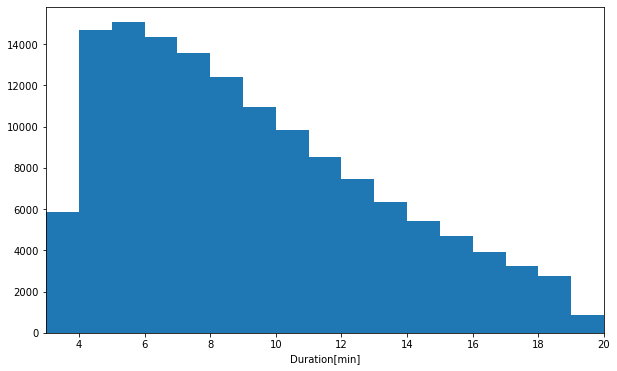

In [49]:
# plot an histogram using matplotlib
binsize= 1
bins = np.arange(0, df_FordGoBike_clean['duration_min'].max()+ binsize, binsize)

plt.figure(figsize=[10, 6])
plt.hist(data = df_FordGoBike_clean, x = 'duration_min', bins = bins)
plt.xlim([3,20])
plt.xlabel('Duration[min]')
plt.show()

The duration in minutes take on a range of values, from about 3 mins to about 20 mins. It is seen that most trips had duration between about 5 mins to about 8mins. The number of trips decreased gradually as the duration increases from about 8 mins to about 20 mins.

There was a sharp increase in the number of trips between about 3 mins and about 5 mins.

### Lets consider another variable of interest: member_age

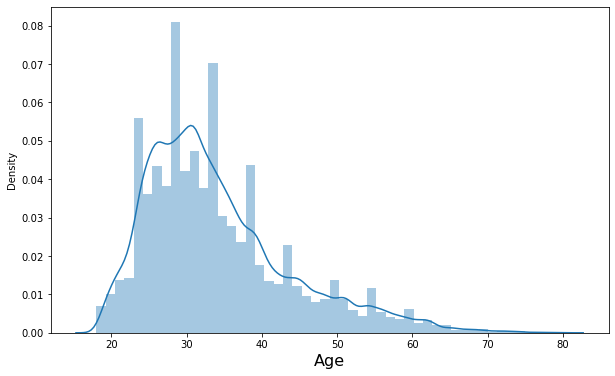

In [50]:
# plot an histogram with kde using seaborn
plt.figure(figsize= (10,6))
sns.distplot(df_FordGoBike_clean['member_age'], kde= True)
plt.xlabel('Age', fontsize= 16);

The age distribution in the data is skewed to the right since a little number of users are old(between age 50yrs to about 80yrs). User between the age of about 25yrs to about 35yrs seem to be high in population.

### Lets consider another variable of interest: user_type

In [51]:
# Visualization of seaborn color palette
sns.color_palette()

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

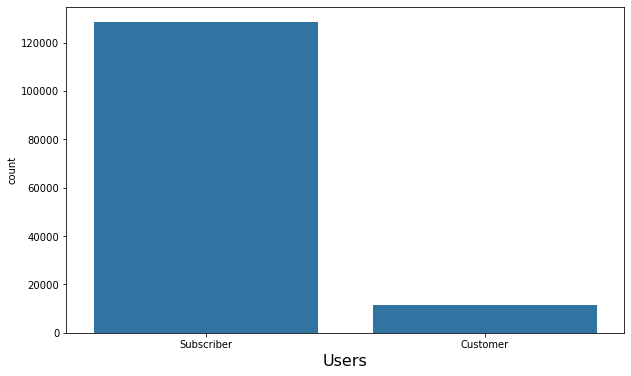

In [52]:
# assign the first color of the seaborn color palette to a variable.
base_color= sns.color_palette()[0]

# Order the user type  data and assign it to a variable
user_order= df_FordGoBike_clean['user_type'].value_counts().index

# plot a barchart using seaborn
plt.figure(figsize= (10,6))
sns.countplot(data= df_FordGoBike_clean, x= 'user_type', color= base_color, order= user_order)
plt.xlabel('Users', fontsize= 16)
plt.show();

Subscribers seem to be more in number as compared to customers.

### Lets consider another variable of interest: member_gender

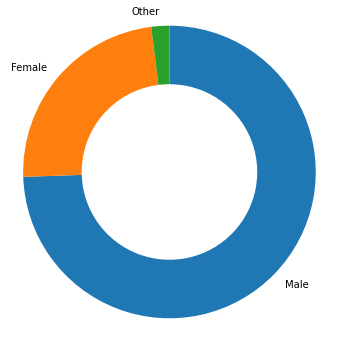

In [53]:
# Order the gender data and assign it to a variable
sorted_gender= df_FordGoBike_clean['member_gender'].value_counts()

# plot a donut chart using matplotlib
plt.figure(figsize= (10,6))
plt.pie(sorted_gender, labels= sorted_gender.index, startangle= 90, counterclock= False, wedgeprops= {'width': 0.4});
plt.axis('square');

Males seems to be more than the female and other gender.

### Lets Consider another variable of interest: start_hour

In [54]:
# Order the start_hour data and assign it to a variable
hour= df_FordGoBike_clean['start_hour'].value_counts(sort= False)
hour

23     1178
22     2136
21     3403
20     4814
19     7537
18    13262
17    17265
16    10794
15     6563
14     5656
13     5971
12     5984
11     5469
10     6217
9     12972
8     17242
7      8562
6      2759
5       662
4       150
3       104
2       255
1       376
0       634
Name: start_hour, dtype: int64

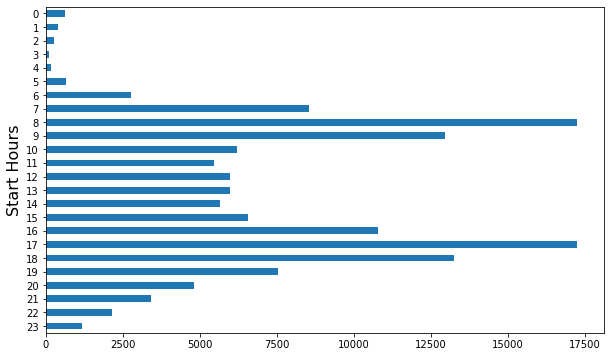

In [55]:
# plot an horizontal bar chart using pandas plot function
hour.plot(kind= 'barh', color= base_color, figsize= (10,6))
plt.ylabel('Start Hours', fontsize= 16)
plt.show();

Most Users seem to ride at the 8th and 17th hour of the day with few rides recorded at the early hours of the day.

## Bivariate Exploration

In [56]:
# Inspect the correlation between numerical features of the dataset
df_FordGoBike_clean.corr()

,start_station_latitude,start_station_longitude,duration_min,member_age,start_hour
start_station_latitude,1.000000,-0.694430,0.017572,0.084928,-0.020564
start_station_longitude,-0.694430,1.000000,-0.142417,-0.127163,0.057139
duration_min,0.017572,-0.142417,1.000000,0.017598,-0.023352
member_age,0.084928,-0.127163,0.017598,1.000000,-0.059846
start_hour,-0.020564,0.057139,-0.023352,-0.059846,1.000000


### Lets consider the relationship between member_age and duration_min.

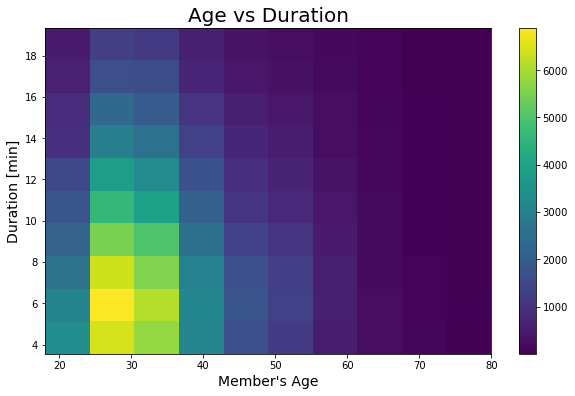

In [57]:
# plot a heatmap using matplotlib
plt.figure(figsize= (10, 6))
plt.hist2d(data= df_FordGoBike_clean, x= "member_age", y= "duration_min")
plt.xlabel("Member's Age", fontsize= 14)
plt.ylabel("Duration [min]", fontsize= 14)
plt.title("Age vs Duration", fontsize= 20)
plt.colorbar(); 

There is a wide range of Users from about 18yrs to about 80yrs. Users between the age of 18yrs - 40yrs spends more time riding with a high concentration of Users between 25yrs to 35yrs. Most Users between 25yrs to 35yrs spend about 10 mins riding with more concentartion on 6 mins.

### Lets consider the relationship between member_gender and duration_min.

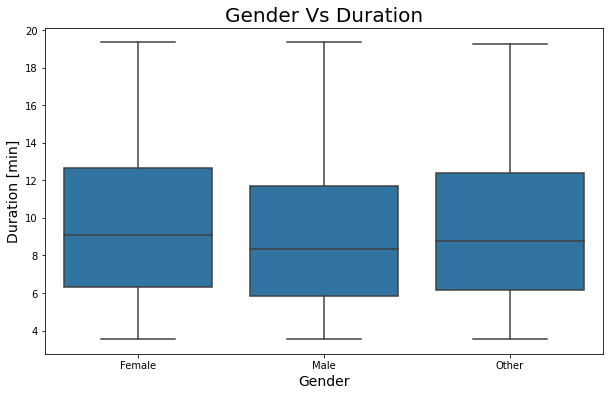

In [58]:
# plot a boxplot using seaborn
plt.figure(figsize= (10, 6))
sns.boxplot(data= df_FordGoBike_clean, x= "member_gender", y= "duration_min", color= base_color)
plt.xlabel("Gender", fontsize= 14)
plt.ylabel("Duration [min]", fontsize= 14)
plt.title("Gender Vs Duration", fontsize= 20)
plt.show();

Females spend an average of about 9 mins riding while males spend an average of about 8 mins riding, a little lower than the females. The other gender spends an average of 9mins riding. The Upper quartile of female riding duration is about 13 mins, for male its about 11 mins and for the other gender, its about 12 mins. All gender have their minimum and maximum riding duration at about 3 mins and about 19 mins respectively.

### Lets consider the relationship between user_type and duration_min

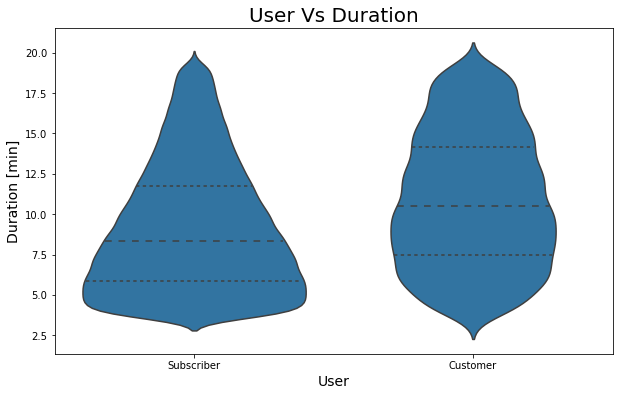

In [59]:
# plot a violin_plot using seaborn
plt.figure(figsize= (10, 6))
sns.violinplot(data= df_FordGoBike_clean, x= "user_type", y= "duration_min", color= base_color, inner= "quartile")
plt.xlabel("User", fontsize= 14)
plt.ylabel("Duration [min]", fontsize= 14)
plt.title("User Vs Duration", fontsize= 20)
plt.show();

Subscribers spend an average of 9 mins riding while Customers spend an average of about 11 mins riding. Customers tend to have higher riding duration than subscribers. The upper quartile of customers riding duration is a little below 15 mins while the upper quartile of subcribers riding duration is a little below 12.5 mins. Subscribers with riding duration between 5 mins and 7.5 mins tend to be concentrated. The customers are normally spread between the minimum duration and the maximum duration unlike the subscribers with few people having riding duration above 15 mins.

### Lets consider the relationship between member_gender and user_type

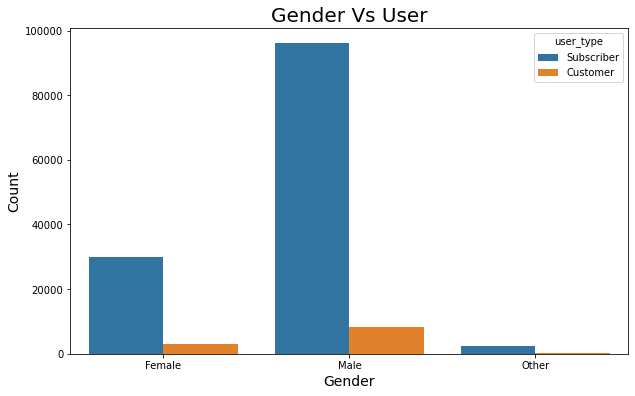

In [60]:
# Plot a clustered bar chart using seaborn
plt.figure(figsize= (10, 6))
sns.countplot(data= df_FordGoBike_clean, x= "member_gender", hue= "user_type")
plt.xlabel("Gender", fontsize= 14)
plt.ylabel("Count", fontsize= 14)
plt.title("Gender Vs User", fontsize= 20)
plt.show();

Among the gender of the user, more users tend to be subscribers.

### Lets consider the relationship between Start_hour and Average duration

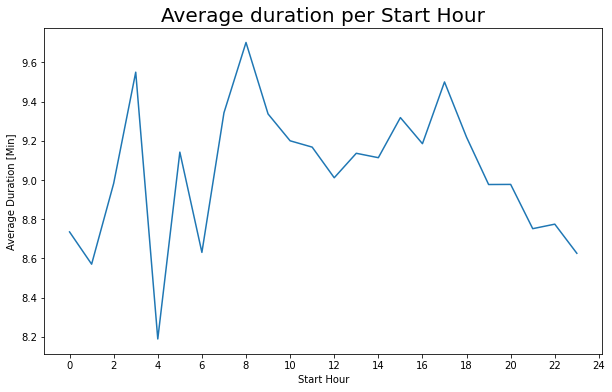

In [61]:
# plot a lineplot using pandas plot function
df_FordGoBike_clean.groupby("start_hour")["duration_min"].mean().plot(kind= "line", figsize= (10,6), color= base_color)
plt.title("Average duration per Start Hour", fontsize= 20)
plt.xlabel("Start Hour")
plt.ylabel("Average Duration [Min]")
plt.xticks([x for x in range(0,25,2)])
plt.show();

At the start of the day, the riding duration takes an haphazard look with it peaks (9.6 mins and 9.8 mins) at the 3rd and 8th hour of the day respectively. The hour with the least duration is the 4th hour of the day. From the 17th hour having a peak of 9.5 mins, there is a steady decline in riding duration till the end of the day. People tends to spend more time riding between the 5th and 9th hours of the day.

### Lets consider the relationship between Day of Month and Average duration

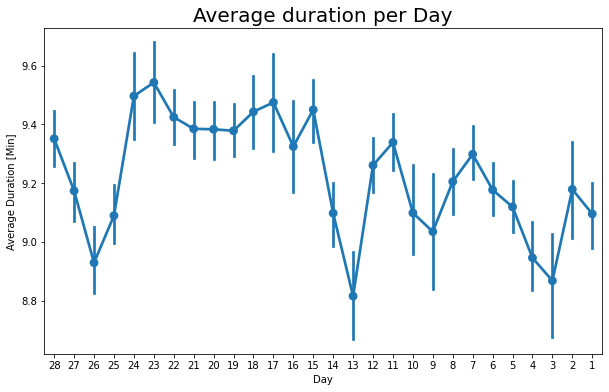

In [62]:
# plot a point_point using seaborn
plt.figure(figsize= (10, 6))
sns.pointplot(data= df_FordGoBike_clean, x= "day", y= "duration_min", color= sns.color_palette()[0])
plt.title("Average duration per Day", fontsize= 20)
plt.xlabel("Day")
plt.ylabel("Average Duration [Min]")
plt.show();

In the month of february, 2019, Day 13 recorded the least average riding duration while Day 23 recorded the highest average riding duration. The average duration recorded in other days of the month tends to range between 8.8 mins and 9.5 mins.

## Multivariate Exploration

### Lets consider the relationship between Gender, Day and Average duration

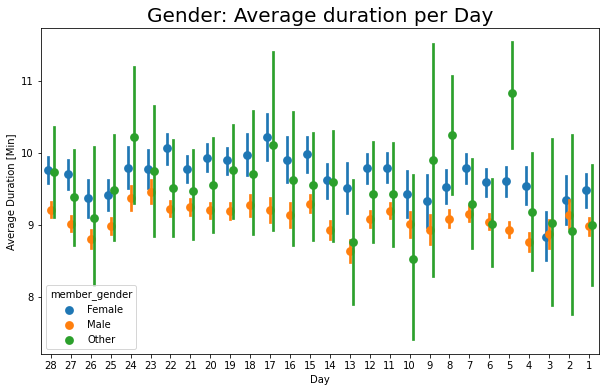

In [63]:
# plot a multivariate point_plot using seaborn
plt.figure(figsize= (10, 6))
sns.pointplot(data= df_FordGoBike_clean, x= "day", y= "duration_min", hue= "member_gender", dodge= 0.3, linestyles= "")
plt.title("Gender: Average duration per Day", fontsize= 20)
plt.xlabel("Day")
plt.ylabel("Average Duration [Min]")
plt.show();

The male gender tend to have the least average duration per day of the month ranging from 8.5 mins to 9.5 mins. The female gender has an average duarion per day ranging from 9.0 mins to a little below 10.5 mins. The other gender has a wude range of average duarion per day from 8.5 mins to a little below 11 mins. 

### Lets consider the relationship between User Type, Gender and Average duration

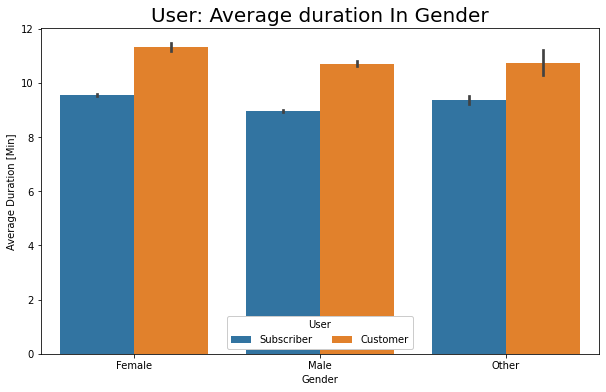

In [64]:
# plot a multivariate clustered bar chart using seaborn
plt.figure(figsize=(10,6))
ax= sns.barplot(data= df_FordGoBike_clean, x= "member_gender", y= "duration_min", hue= "user_type")
ax.legend(loc= 8, ncol=3, framealpha= 1,  title= "User")
plt.title("User: Average duration In Gender", fontsize= 20)
plt.xlabel("Gender")
plt.ylabel("Average Duration [Min]")
plt.show();

Among all the gender, the customers spends more time riding with an average duration above 10 mins. Female customers tend to have the highest duration of  about 11 mins.

### Lets consider the relationship between all numerical features.

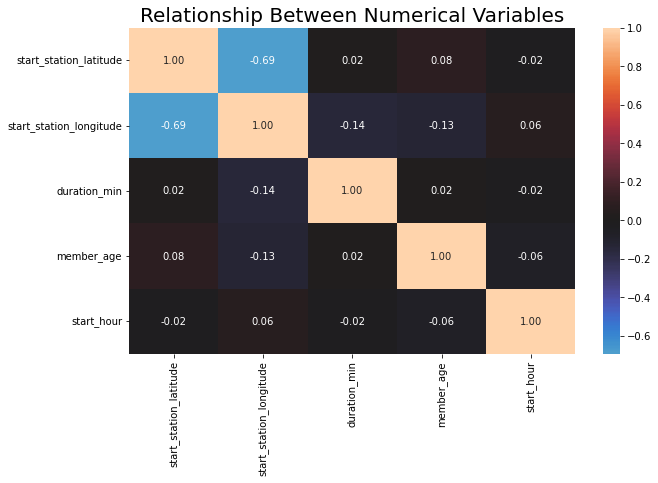

In [65]:
# plot a heatmap of all numerical features in the dataset using seaborn
plt.figure(figsize= (10,6))
sns.heatmap(df_FordGoBike_clean.corr(), annot= True, fmt= ".2f", cmap= "icefire", center= 0)
plt.title("Relationship Between Numerical Variables", fontsize= 20)
plt.show();

The latitude and longitude correlate negatively with a correlation coeficient of 0.69. Other numerical features have little ccorrelation with each other making them suitable in creating a model that aids in predicting duration.

### Lets consider the Effect of Location on the Duration.

In [66]:
# plot a map showing location of stations using plotly.express
fig = px.scatter_mapbox(
    df_FordGoBike_clean,  # our DataFrame
    lat="start_station_latitude",
    lon="start_station_longitude",
    width=600,  # width of map
    height=600,  # weight of map
    color="duration_min",
    hover_data=["duration_min"],  # display duration when hovering mouse over station
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()


The stations seems to be distributed along the coastal areas of san francisco (San Francisco Bay) with fewer station having high duration between 16mins and 18mins and most stations having duration between 8 mins to 12 mins.

# Conclusion

### When are most trips taken in terms of time of day, day of the month?

- Most Users seem to ride at the 8th and 17th hour of the day with few rides recorded at the early hours of the day.


- In the month of february, 2019, Day 13 recorded the least average riding duration while Day 23 recorded the highest average riding duration. The average duration recorded in other days of the month tends to range between 8.8 mins and 9.5 mins.

### How long does the average trip per hour take?

- At the start of the day, the average riding duration takes an haphazard look with it peaks (9.6 mins and 9.8 mins) at the 3rd and 8th hour of the day respectively. The hour with the least avaerage duration is the 4th hour of the day. From the 17th hour having a peak of 9.5 mins, there is a steady decline in the average riding duration till the end of the day. People tends to spend more time riding between the 5th and 9th hours of the day.

### Does the length of the average trip depends on if a user is a subscriber or a customer?

- Subscribers seem to be more in number as compared to customers.


- Among all the gender, the customers spends more time riding with an average duration above 10 mins. Female customers tend to have the highest duration of about 11 mins.